<a href="https://colab.research.google.com/github/CrystalParaboy/cuhk-gis-bigdata/blob/main/Tutorial_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1 Clustering on spatial data


In [3]:
!pip install sklearn # an important machine learning package

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


In [4]:
# Generate some random coordinates at Shanghai
import numpy as np
import pandas as pd

from sklearn.datasets import make_blobs

sh_lat = 31.22 
sh_lng = 121.46

data, label = make_blobs(n_samples=100, n_features=2, centers=5) # five clusters, randomly

sample_data =pd.DataFrame(data = data*0.01 + np.array([sh_lat,sh_lng]),  
                  columns = ["y", "x"]) 

sample_data.head(10) # show the top rows

,y,x
0,31.194183,121.520767
1,31.181775,121.517269
2,31.262435,121.469834
3,31.185708,121.524193
4,31.150903,121.433144
5,31.147213,121.470352
6,31.270521,121.471757
7,31.186360,121.526443
8,31.141582,121.417493
9,31.285906,121.477876


In [5]:
# plot in map
!pip install folium
import folium

gaode = 'http://wprd03.is.autonavi.com/appmaptile?style=7&x={x}&y={y}&z={z}' 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## 1.3 Shared bike O-D

In [6]:
# load a mobike data in Shanghai
mobike_df = pd.read_csv('https://github.com/gyshion/tutorial/raw/main/mobike_shanghai1.csv')
mobike_df

,orderid,bikeid,userid,start_time,start_location_x,start_location_y,end_time,end_location_x,end_location_y,track
0,78387,158357,10080,2016-08-20 06:57,121.34860,31.38844,2016-08-20 07:04,121.35731,31.38846,NaN
1,891333,92776,6605,2016-08-29 19:09,121.50808,31.27989,2016-08-29 19:31,121.48925,31.27156,NaN
2,1106623,152045,8876,2016-08-13 16:17,121.38256,31.25409,2016-08-13 16:36,121.40445,31.24789,NaN
3,1389484,196259,10648,2016-08-23 21:34,121.48472,31.31914,2016-08-23 21:43,121.47078,31.32401,NaN
4,188537,78208,11735,2016-08-16 07:32,121.40655,31.29142,2016-08-16 07:41,121.41701,31.28734,NaN
...,...,...,...,...,...,...,...,...,...,...
102356,1479550,214335,1423,2016-08-28 18:03,121.47716,31.29627,2016-08-28 18:09,121.48110,31.30321,NaN
102357,1478273,160487,3067,2016-08-14 20:22,121.32073,31.23861,2016-08-14 20:28,121.31166,31.23460,NaN
102358,367733,179530,12746,2016-08-27 09:54,121.39125,31.30636,2016-08-27 10:06,121.39788,31.30559,NaN
102359,64915,167419,837,2016-08-20 06:04,121.51414,31.26882,2016-08-20 06:10,121.50941,31.27181,NaN


In [7]:
# Plot 1% of the Origin-destination line from mobike data

map_sh = folium.Map(location=[sh_lat,sh_lng],tiles=gaode, attr = 'shared bike')

for index, row in mobike_df.iterrows():
    #if index%100 == 0: # 100, 200, 300 ...
    if index%10 == 0: # 10%
        OD = [
            [row['start_location_y'],row['start_location_x']],
            [row['end_location_y'],row['end_location_x']]]
        
        folium.PolyLine(OD, color='red').add_to(map_sh)
map_sh

## 1.4 Try DBscan on Mobike dataset

In [8]:
# stack the origin points with destination points
new_ll = []

for index, row in mobike_df.iterrows():
    new_ll.append([row['start_location_y'],row['start_location_x']])
    new_ll.append([row['end_location_y'],row['end_location_x']])

all_pt =pd.DataFrame(data = new_ll, columns = ["y", "x"]) 

all_pt.head(5) # plot 5 rows

,y,x
0,31.38844,121.34860
1,31.38846,121.35731
2,31.27989,121.50808
3,31.27156,121.48925
4,31.25409,121.38256


In [10]:
from sklearn.cluster import DBSCAN
db_mobike = DBSCAN(eps = 0.0005, # ~ 50 meter
                   min_samples = 20).fit(all_pt[['y','x']]) # train the model 

In [11]:
predict_mobike = db_mobike.fit_predict(all_pt[['y','x']]) # predict by the model
all_pt['label'] = predict_mobike

all_pt

,y,x,label
0,31.38844,121.34860,-1
1,31.38846,121.35731,-1
2,31.27989,121.50808,324
3,31.27156,121.48925,-1
4,31.25409,121.38256,-1
...,...,...,...
204717,31.30559,121.39788,-1
204718,31.26882,121.51414,-1
204719,31.27181,121.50941,111
204720,31.26095,121.52049,-1


In [12]:
# assign color for different labels
import random
def random_color(seed):
    random.seed(seed+10)
    return "#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])

print(random_color(4435)) # return the same color code for same seed

#2FB3E3


In [13]:
# check how many clusters we have
np.unique(predict_mobike)

array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
        12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
        25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
        38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
        51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
        64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
        77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
        90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
       103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
       116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
       129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
       142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
       155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
       168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 17

In [14]:
map_sh_4 = folium.Map(location=[sh_lat,sh_lng],tiles=gaode,attr='test')

for index, row in all_pt.iterrows():
    if row['label']>=0:
      if random.random()<0.30: # only 2%
        folium.CircleMarker(
            [row['y'],row['x']],
            color = random_color(row['label']),
            radius=3,
            fill=True
        ).add_to(map_sh_4)
map_sh_4

In [15]:
# assign the cluster to OD points
mobike_df['start_cluster'] = db_mobike.fit_predict(mobike_df[['start_location_y','start_location_x']]) # predict by the model
mobike_df['end_cluster'] = db_mobike.fit_predict(mobike_df[['end_location_y','end_location_x']]) # predict by the model
mobike_df

,orderid,bikeid,userid,start_time,start_location_x,start_location_y,end_time,end_location_x,end_location_y,track,start_cluster,end_cluster
0,78387,158357,10080,2016-08-20 06:57,121.34860,31.38844,2016-08-20 07:04,121.35731,31.38846,NaN,-1,-1
1,891333,92776,6605,2016-08-29 19:09,121.50808,31.27989,2016-08-29 19:31,121.48925,31.27156,NaN,-1,-1
2,1106623,152045,8876,2016-08-13 16:17,121.38256,31.25409,2016-08-13 16:36,121.40445,31.24789,NaN,-1,-1
3,1389484,196259,10648,2016-08-23 21:34,121.48472,31.31914,2016-08-23 21:43,121.47078,31.32401,NaN,0,-1
4,188537,78208,11735,2016-08-16 07:32,121.40655,31.29142,2016-08-16 07:41,121.41701,31.28734,NaN,-1,-1
...,...,...,...,...,...,...,...,...,...,...,...,...
102356,1479550,214335,1423,2016-08-28 18:03,121.47716,31.29627,2016-08-28 18:09,121.48110,31.30321,NaN,-1,-1
102357,1478273,160487,3067,2016-08-14 20:22,121.32073,31.23861,2016-08-14 20:28,121.31166,31.23460,NaN,-1,-1
102358,367733,179530,12746,2016-08-27 09:54,121.39125,31.30636,2016-08-27 10:06,121.39788,31.30559,NaN,-1,-1
102359,64915,167419,837,2016-08-20 06:04,121.51414,31.26882,2016-08-20 06:10,121.50941,31.27181,NaN,-1,-1


In [16]:
# filter only the od among clusters

mobike_df_cluster = mobike_df.query("start_cluster>=0 and end_cluster>=0") # keep the od from cluster to cluster
mobike_df_cluster


,orderid,bikeid,userid,start_time,start_location_x,start_location_y,end_time,end_location_x,end_location_y,track,start_cluster,end_cluster
10,903987,13745,3117,2016-08-09 19:51,121.51383,31.30629,2016-08-09 19:59,121.50973,31.30368,NaN,1,24
103,401996,190120,10705,2016-08-18 14:19,121.50016,31.27995,2016-08-18 14:24,121.50114,31.27495,NaN,7,43
108,1504315,78807,185,2016-08-16 19:56,121.47998,31.31174,2016-08-16 20:04,121.48318,31.30466,NaN,74,4
164,656877,144426,2567,2016-08-10 20:06,121.48414,31.30630,2016-08-10 20:13,121.47944,31.31052,NaN,8,7
243,914890,122026,6806,2016-08-23 12:10,121.53261,31.33058,2016-08-23 12:17,121.53350,31.33020,NaN,85,81
...,...,...,...,...,...,...,...,...,...,...,...,...
101855,788033,324054,14436,2016-08-30 09:54,121.53078,31.31458,2016-08-30 10:02,121.52140,31.31666,NaN,16,52
102026,371933,119743,9402,2016-08-10 14:59,121.53256,31.32382,2016-08-10 15:05,121.53758,31.32769,NaN,13,76
102285,1018326,45228,9117,2016-08-23 13:39,121.51325,31.30227,2016-08-23 13:47,121.51034,31.30677,NaN,2,105
102298,1241599,206321,15673,2016-08-27 17:23,121.51484,31.30759,2016-08-27 17:48,121.53240,31.30517,NaN,1,21


In [17]:
# Plot 100% of the Origin-destination line from mobike data with the cluster

map_sh_4 = folium.Map(location=[sh_lat,sh_lng],tiles=gaode,attr='test')

for index, row in mobike_df_cluster.iterrows():
    if index%1==0:
        OD = [
            [row['start_location_y'],row['start_location_x']],
            [row['end_location_y'],row['end_location_x']]]
        folium.PolyLine(OD,weight=0.5,color = 'black').add_to(map_sh_4)
        
        
        folium.CircleMarker(
            [row['start_location_y'],row['start_location_x']],
            color = random_color(row['start_cluster']),
            radius=3,
            fill=True
        ).add_to(map_sh_4)

        folium.CircleMarker(
            [row['end_location_y'],row['end_location_x']],
            color = random_color(row['end_cluster']),
            radius=3,
            fill=True
        ).add_to(map_sh_4)
        
map_sh_4

In [18]:
# extract the network from shared bike data
od = dict() # empty dict 
for index, row in mobike_df_cluster.iterrows(): #loop over every row
  od_idx = (row['start_cluster'], row['end_cluster']) # od_idx is the od index, eg: 2->4
  if od_idx not in od: # if the od idx not in dict
    od[od_idx] = 1
  else:
    od[od_idx] += 1

print(od)



{(1, 24): 5, (7, 43): 3, (74, 4): 28, (8, 7): 14, (85, 81): 1, (57, 11): 20, (23, 4): 12, (12, 33): 7, (82, 33): 3, (0, 67): 8, (16, 90): 3, (13, 64): 10, (36, 4): 1, (36, 11): 1, (16, 33): 3, (13, 90): 5, (62, 36): 2, (13, 76): 11, (16, 41): 4, (55, 24): 1, (4, 2): 4, (80, 39): 1, (10, 38): 25, (86, 33): 1, (37, 4): 10, (49, 27): 4, (11, 30): 2, (45, 8): 2, (85, 0): 14, (8, 63): 21, (24, 5): 2, (52, 10): 2, (41, 45): 1, (17, 63): 1, (34, 18): 1, (4, 49): 1, (67, 43): 1, (59, 101): 3, (2, 55): 5, (41, 55): 1, (80, 33): 1, (2, 77): 6, (13, 81): 12, (57, 3): 2, (98, 11): 6, (59, 34): 6, (52, 26): 1, (40, 10): 2, (108, 58): 1, (16, 52): 8, (2, 33): 3, (23, 45): 1, (61, 42): 2, (67, 25): 1, (15, 47): 3, (27, 13): 1, (53, 11): 2, (60, 27): 1, (72, 4): 1, (64, 21): 3, (70, 77): 1, (59, 26): 1, (1, 55): 2, (8, 75): 4, (4, 57): 2, (60, 8): 3, (79, 12): 1, (0, 7): 2, (25, 85): 6, (2, 24): 11, (21, 86): 1, (24, 50): 1, (34, 13): 1, (59, 97): 1, (72, 79): 1, (37, 26): 1, (5, 11): 2, (16, 27): 2, 

# 2 Network

## 2.1 Network representing

In [2]:
!pip install networkx --user # most important network module
!pip install matplotlib --user # plot data
import networkx as nx
import matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Create network from share bike data

In [19]:
# import the data into a new network
G_bike=nx.Graph() 

pos_bike = dict() #store the location of airports
num = 0
for index, row in mobike_df_cluster.iterrows():
    travel_num = row['start_cluster'] + row['end_cluster']
    if travel_num > 60 : # only the travel_num with >60 tracks would be included
        num=num+1
        dep = str(row['start_location_y'])+','+str(row['start_location_x'])
        arr = str(row['end_location_y'])+','+str(row['end_location_x'])
        G_bike.add_edge(dep,arr,weight=travel_num)
        pos_bike[dep] = [row['start_location_y'],row['start_location_x']]
        pos_bike[arr] = [row['end_location_y'],row['end_location_x']]

In [20]:
num

456

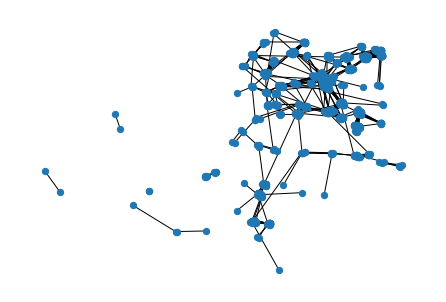

In [21]:
nx.draw(G_bike,pos=pos_bike,node_size=40)

Use network analysis on the shared bike network

In [22]:
# calculate the eigenvector_centrality

eigenvector_centrality_map = nx.algorithms.centrality.eigenvector_centrality(G_bike,max_iter=500,weight='weight')
print(eigenvector_centrality_map)

{'31.31174,121.47998': 2.7898829155428398e-27, '31.30466,121.48318': 2.7898829155428398e-27, '31.33058,121.53261': 0.0003364588430716773, '31.3302,121.5335': 0.0003364588430716773, '31.31773,121.47297': 1.8721814512048544e-31, '31.32052,121.48275': 1.8721814512048544e-31, '31.30454,121.50439': 1.9524491457116702e-15, '31.30275,121.51349': 1.9524491457116702e-15, '31.31923,121.48241': 6.640416161922734e-32, '31.33053,121.47407': 6.640416161922734e-32, '31.31345,121.5312': 6.314089178000116e-18, '31.32105,121.54016': 6.314089178000116e-18, '31.32224,121.53071': 1.1292218859178864e-27, '31.33057,121.53672': 1.1292218859178864e-27, '31.32264,121.53191': 8.383581410285759e-19, '31.32061,121.54054': 8.383581410285759e-19, '31.2504,121.43246': 2.5360704410702274e-20, '31.24587,121.42862': 2.5360704410702274e-20, '31.32263,121.53059': 2.919313031777365e-23, '31.32761,121.53744': 2.919313031777365e-23, '31.30432,121.53168': 6.814775795203987e-27, '31.30426,121.51042': 6.814775795203987e-27, '31

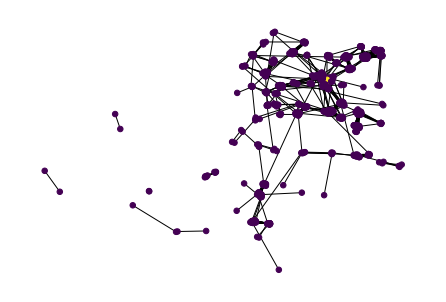

In [23]:
nx.draw(G_bike,pos=pos_bike,node_size=30,node_color=list(eigenvector_centrality_map.values()))

## Plot it on folium


plot the cluster with high importance, like larger than 0.1


In [24]:
# all link of a graph
for link in G_bike:
  #print(link)
  link

In [25]:
# all node importance
for k in eigenvector_centrality_map:
  if eigenvector_centrality_map[k]>=0.1:
      print('coor:',k,', eigenvector:',eigenvector_centrality_map[k])

coor: 31.30426,121.5119 , eigenvector: 0.7071011364583286
coor: 31.30374,121.5082 , eigenvector: 0.7071011364583286


In [26]:
# todo: plot the data on the folium map

map_bikes = folium.Map(location=[sh_lat,sh_lng],tiles=gaode,attr='test')
# refer to 1.4

for k in eigenvector_centrality_map:
  lnglat = k.split(',') # split the coordiante string into lng and lat
  folium.CircleMarker(
      [float(lnglat[0]), float(lnglat[1])],
      radius=eigenvector_centrality_map[k]*50,
      fill=True
  ).add_to(map_bikes)


map_bikes




so the centers of shanghai are two circles on the map

In eigenvector_centrality, I set the travel times as the weight(by add the start_cluster and end_cluster)

I set the center of Shanghai to be the place where bike sharing starts and ends the most